**Advanced Lane Finding Project**

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## 1. Camera calibration using chessboard images


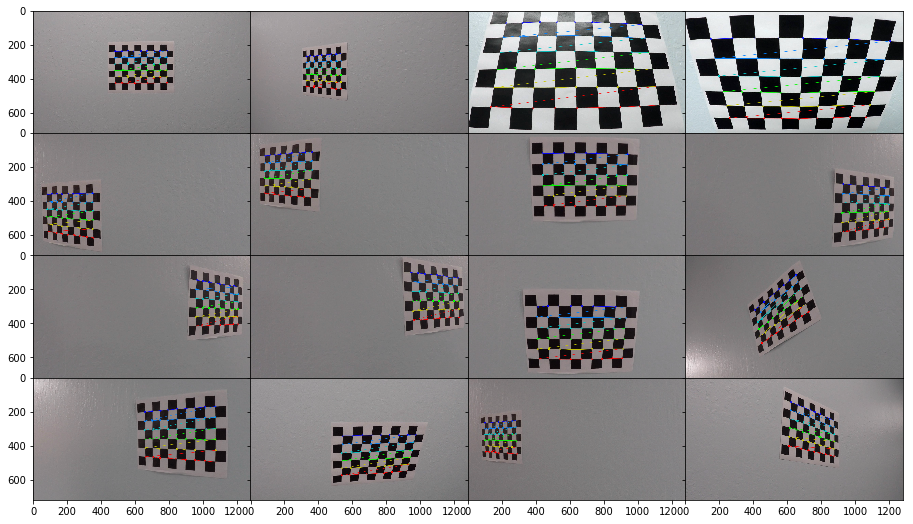

In [324]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
%matplotlib inline


# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
calibration_files = glob.glob('camera_cal/calibration*.jpg')

def show_annotated_images(annotated_images):
    fig = plt.figure(figsize=(29,9))
    grid = ImageGrid(fig, 111, nrows_ncols=(4,4), axes_pad=0.0)
    for p in zip(annotated_images,grid):
        p[1].imshow(p[0][1])
    
    plt.savefig("output_images/draw_corners.jpg",bbox_inches='tight')
    
def measure_distortion(calibration_files):
    annotated_images = []
    for fname in calibration_files:
        #print(fname)
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)
            # Draw and display the corners
            annotated_images.append(cv2.drawChessboardCorners(img, (9,6), corners, ret))
    
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    return mtx, dist,zip(fname, annotated_images)

mtx, dist,annotated_images = measure_distortion(calibration_files)


show_annotated_images(annotated_images)       



## 2.Apply a distortion correction to raw images

In [325]:
import os
def get_undistort_img(img,mtx,dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

def show_undistort_img(filename,image_distorted,image_undistorted):
    filename = os.path.split(filename)[1]
    fig, ((ax1, ax2)) = plt.subplots(1,2,figsize=(24,9))
    ax1.set_title("Distort",fontsize=30,color='r')
    ax1.imshow(image_distorted)
    ax2.set_title("Undistort",fontsize=30,color='r')
    ax2.imshow(image_undistorted)

    fig.savefig("output_images/Undistort_{}".format(filename),bbox_inches='tight')

def show_calib():
    for fname in calibration_files:
        image_distorted = cv2.imread(fname)
        image_undistorted = get_undistort_img(image_distorted,mtx,dist)
        show_undistort_img(fname,image_distorted,image_undistorted)
    


## Pipeline
#### 1. Provide an example of a distortion-corrected image.

To demonstrate this step, I will describe how I apply the distortion correction to one of the test images like this one:


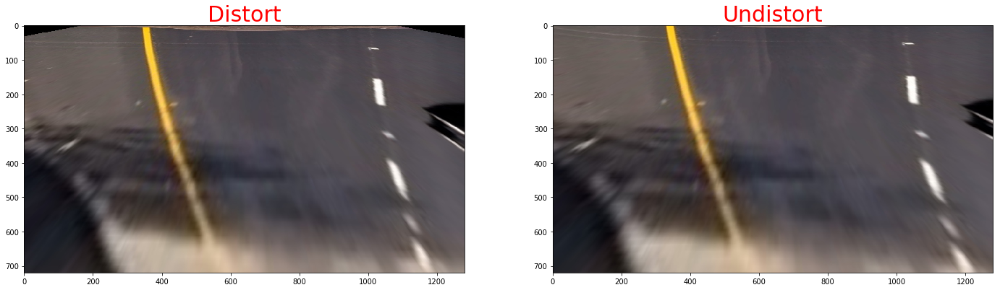

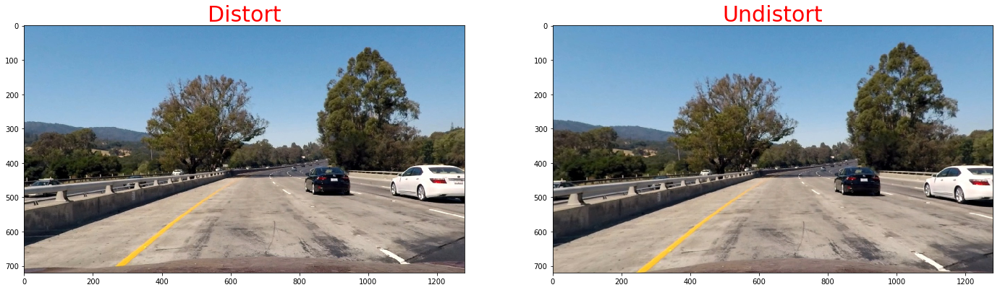

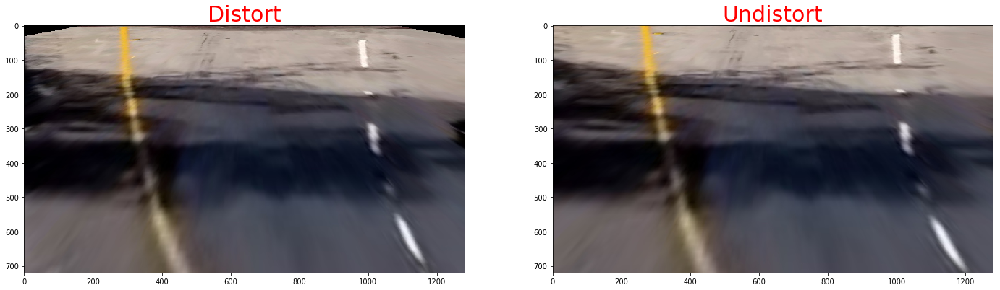

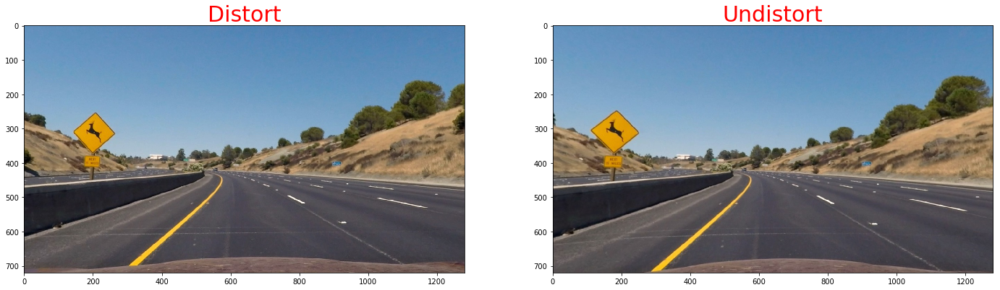

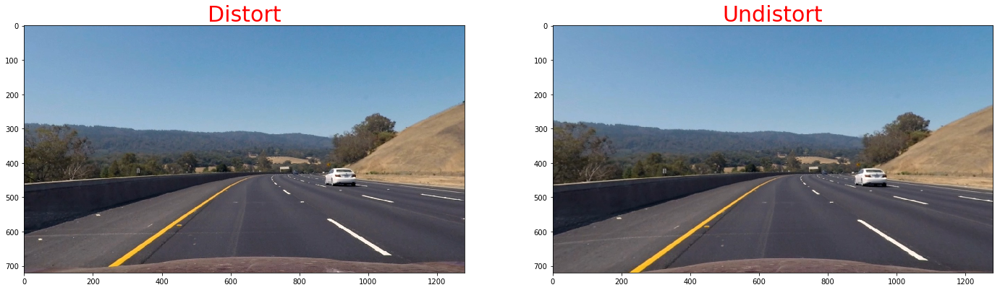

...

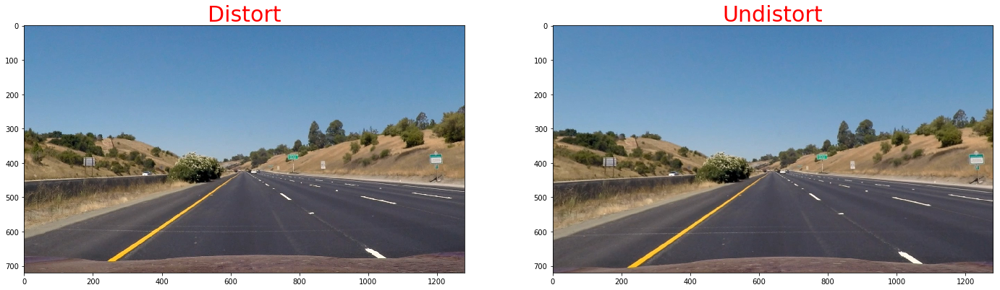

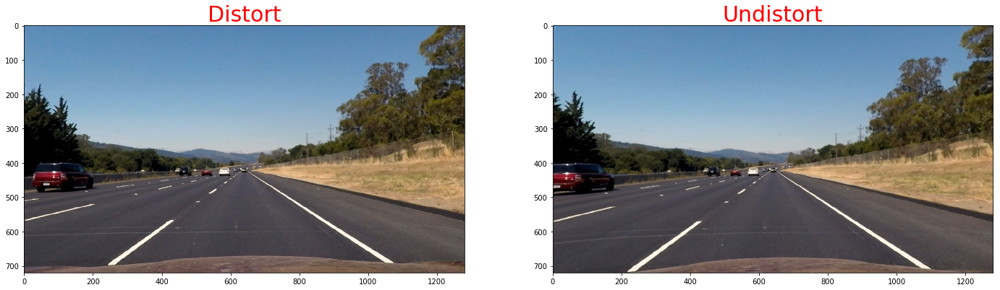

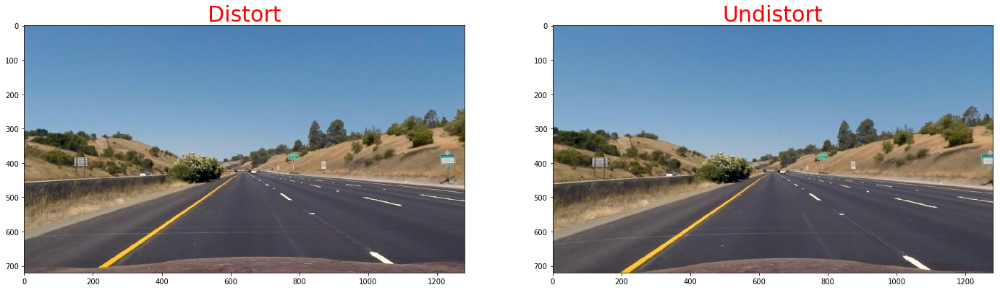

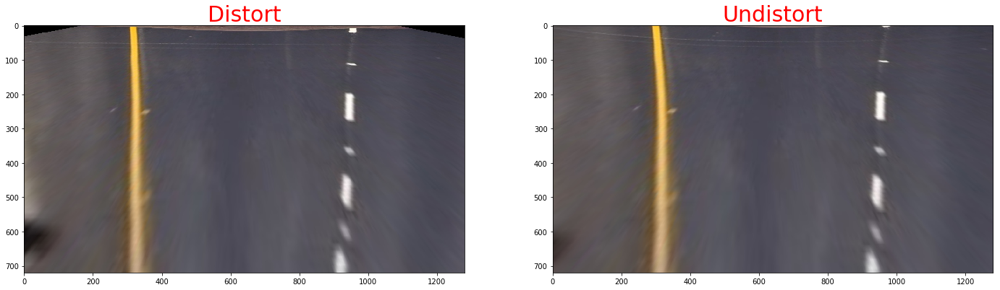

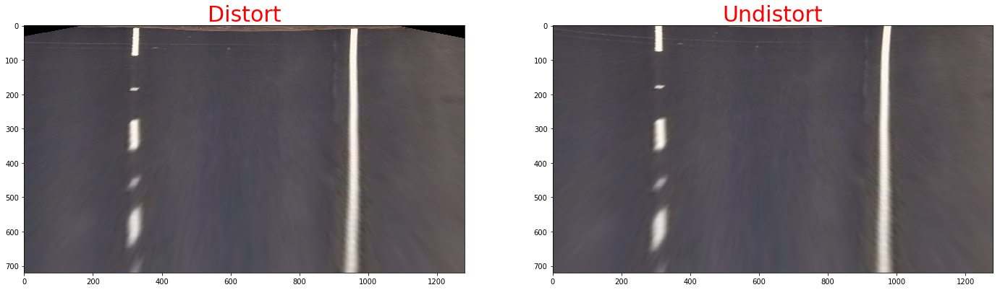

In [326]:
def make_undistort_images():
    distort_images = glob.glob('test_images/*.jpg')
    for fname in distort_images:
        image_distorted = plt.imread(fname)
        image_undistorted = get_undistort_img(image_distorted,mtx,dist)
        plt.imsave("test_images/undistort_"+os.path.split(fname)[1],image_undistorted)
        show_undistort_img(fname,image_distorted,image_undistorted)
        
make_undistort_images()



#### 2. Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image.  Provide an example of a binary image result.

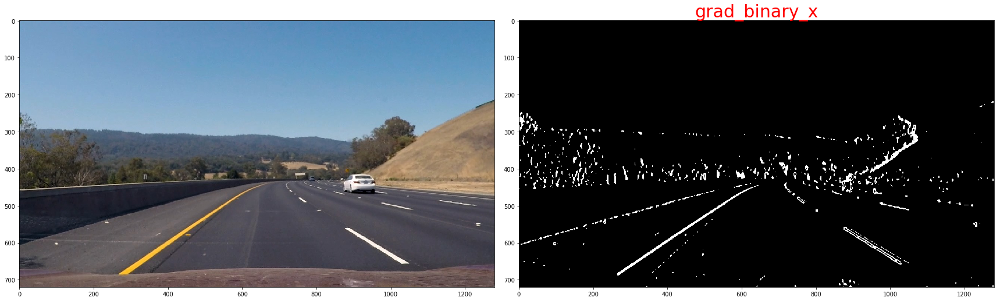

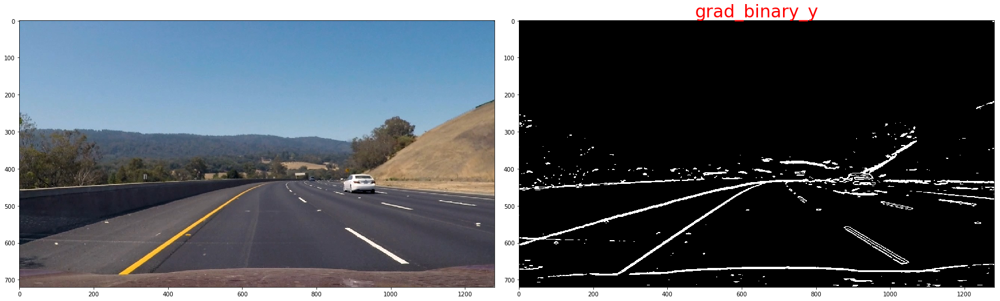

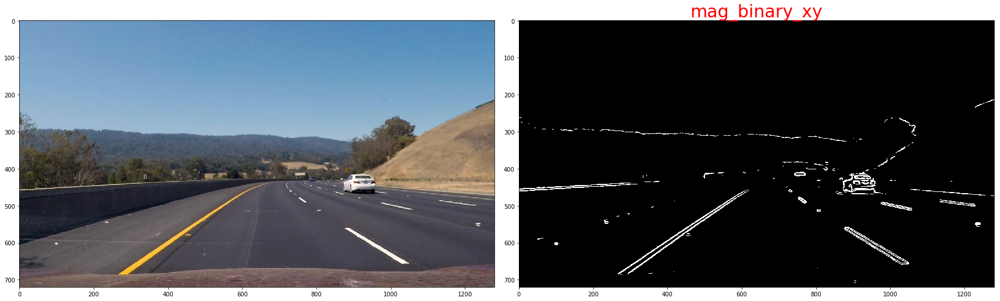

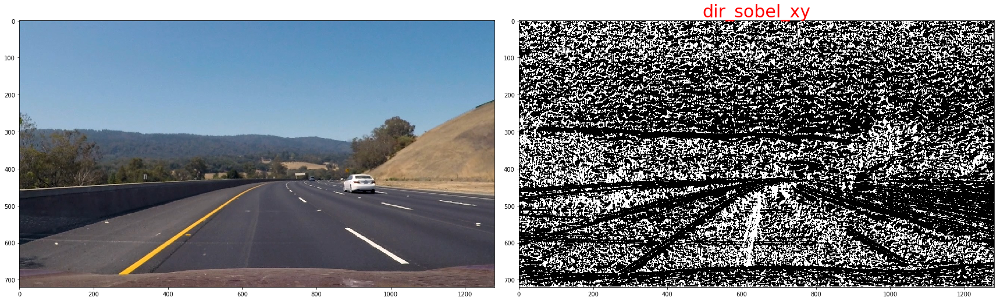

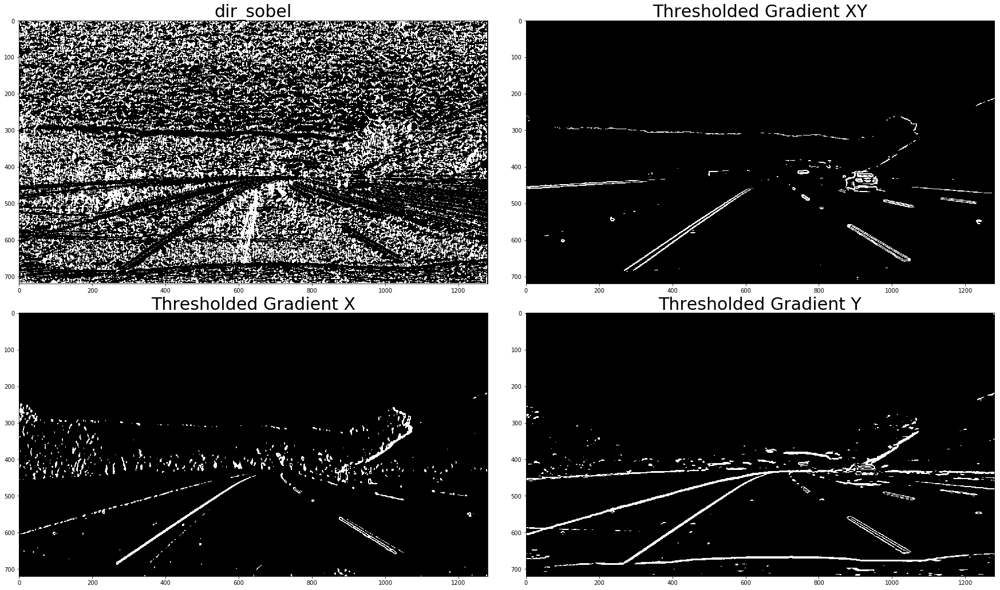

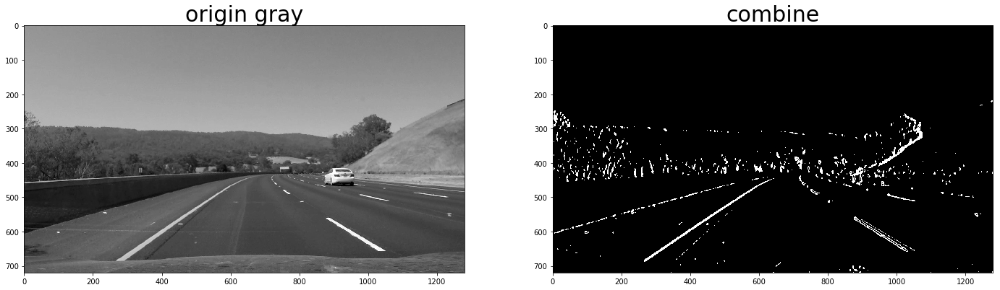

In [338]:
def abs_sobel_thresh(img,orient='x', thresh=(0,255),kernel_size=15):
    # Apply the following steps to img
    # 1) Convert to grayscale
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    # 3) Take the absolute value of the derivative or gradient
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    # 6) Return this mask as your binary_output image
    
    if orient == 'x':
        sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=kernel_size)
        abs_sobelx = np.absolute(sobelx)
        scaled_sobel = np.uint8(255*sobelx/np.max(abs_sobelx))
    elif orient == 'y':
        sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=kernel_size)
        abs_sobely = np.absolute(sobely)
        scaled_sobel = np.uint8(255*sobely/np.max(abs_sobely))
    else:
        pass
        
    gradient_mask = np.zeros_like(scaled_sobel)
    gradient_mask[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return gradient_mask

def abs_mag_sobel(img, thresh=(0, 255), kernel_size=3):
    sobel_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=kernel_size)
    sobel_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=kernel_size)
    
    sobel_xy = np.sqrt(sobel_x**2 + sobel_y**2)
    scaled_xy = np.uint8(255 * sobel_xy / np.max(sobel_xy))
    
    sxy_binary = np.zeros_like(scaled_xy)
    sxy_binary[(scaled_xy >= thresh[0]) & (scaled_xy <= thresh[1])] = 1
    
    return sxy_binary

def dir_sobel(img, thresh=(0, np.pi/2),kernel_size=3):
    sx_abs = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=kernel_size))
    sy_abs = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=kernel_size))
    
    dir_sxy = np.arctan2(sx_abs, sy_abs)

    binary_output = np.zeros_like(dir_sxy)
    binary_output[(dir_sxy >= thresh[0]) & (dir_sxy <= thresh[1])] = 1
    
    return binary_output

def combined_sobels(sx_binary, sy_binary, sxy_magnitude_binary,sxy_direction_binary):    
    combined = np.zeros_like(sxy_direction_binary)
    # Sobel X returned the best output so we keep all of its results. 
    # We perform a binary and on all the other sobels    
    combined[(sx_binary == 1) | ((sy_binary == 1) & (sxy_magnitude_binary == 1) & (sxy_direction_binary == 1))] = 1
    
    return combined


image = plt.imread("test_images/test3.jpg")
gray = cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)#[:,:,2]
grad_binary_x = abs_sobel_thresh(gray, orient='x', thresh=(20,120),kernel_size=15)
grad_binary_y = abs_sobel_thresh(gray, orient='y', thresh=(20,120),kernel_size=15)
mag_binary_xy = abs_mag_sobel(gray, thresh=(80,200),kernel_size=15)
dir_sobel_xy = dir_sobel(gray,thresh=(np.pi/4, np.pi/2),kernel_size=15)

def show_contast(name,after):
    f,((ax1,ax2)) = plt.subplots(1,2,figsize=(24,9))
    f.tight_layout()
    ax1.imshow(image)
    ax2.imshow(after,cmap="gray")
    ax2.set_title(name,fontsize=30,color='r')
    plt.savefig("output_images/{0}".format(name),bbox_inches='tight')
show_contast("grad_binary_x",grad_binary_x)
show_contast("grad_binary_y",grad_binary_y)
show_contast("mag_binary_xy",mag_binary_xy)
show_contast("dir_sobel_xy",dir_sobel_xy)

f, ((ax1, ax2) ,(ax3,ax4)) = plt.subplots(2, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(dir_sobel_xy,cmap="gray")
ax1.set_title('dir_sobel', fontsize=30)
ax2.imshow(mag_binary_xy, cmap='gray')
ax2.set_title('Thresholded Gradient XY', fontsize=30)
ax3.imshow(grad_binary_x, cmap='gray')
ax3.set_title('Thresholded Gradient X', fontsize=30)
ax4.imshow(grad_binary_y, cmap='gray')
ax4.set_title('Thresholded Gradient Y', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=1.5, bottom=0.)
plt.savefig("output_images/threshold.jpg",bbox_inches='tight')

combined_grad = combined_sobels(grad_binary_x,grad_binary_y,mag_binary_xy,dir_sobel_xy)
#print(combined_grad.shape)
fig,((ax1,ax2)) = plt.subplots(1,2,figsize=(24,9))
ax1.imshow(gray,cmap="gray")
ax1.set_title('origin gray', fontsize=30)
ax2.imshow(combined_grad, cmap='gray')
ax2.set_title('combine', fontsize=30)
plt.savefig("output_images/combine.jpg",bbox_inches='tight')

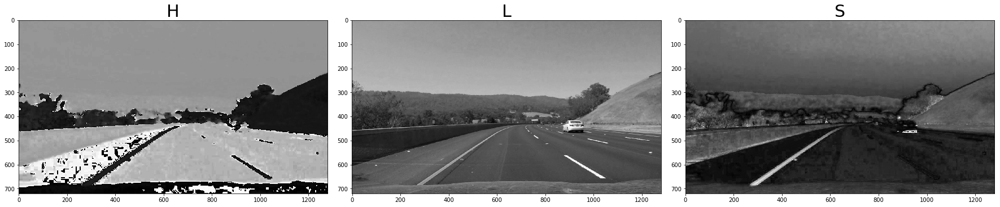

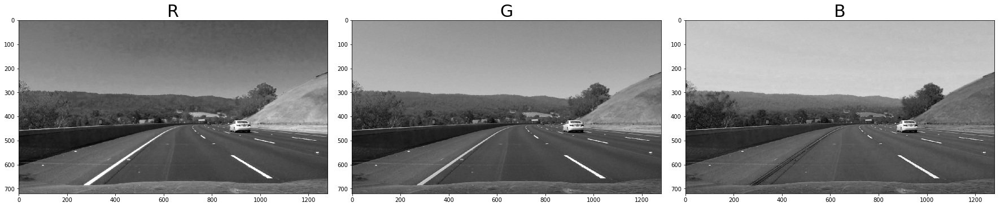

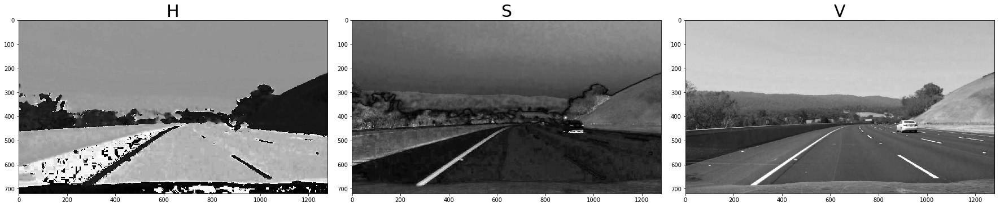

In [340]:
def hls_select(img):
    hls = cv2.cvtColor(img,cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    return H,L,S


def rgb_select(img):
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]
    return R,G,B

def hsv_select(img):
    hsv = cv2.cvtColor(img,cv2.COLOR_RGB2HSV)
    H = hsv[:,:,0]
    S = hsv[:,:,1]
    V = hsv[:,:,2]
    return H,S,V


H,L,S = hls_select(image)
H,S,V = hsv_select(image)
R,G,B = rgb_select(image)


f, ((ax1, ax2, ax3)) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
plt.subplots_adjust(left=0., right=1, top=1.5, bottom=0.)
ax1.imshow(H,cmap="gray")
ax1.set_title('H', fontsize=30)
ax2.imshow(L,cmap="gray")
ax2.set_title('L', fontsize=30)
ax3.imshow(S,cmap="gray")
ax3.set_title('S', fontsize=30)
plt.savefig("output_images/HLS.jpg",bbox_inches='tight')

f, ((ax1, ax2, ax3)) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
plt.subplots_adjust(left=0., right=1, top=1.5, bottom=0.)
ax1.imshow(R,cmap="gray")
ax1.set_title('R', fontsize=30)
ax2.imshow(G,cmap="gray")
ax2.set_title('G', fontsize=30)
ax3.imshow(B,cmap="gray")
ax3.set_title('B', fontsize=30)
plt.savefig("output_images/HSV.jpg",bbox_inches='tight')

f, ((ax1, ax2, ax3)) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
plt.subplots_adjust(left=0., right=1, top=1.5, bottom=0.)
ax1.imshow(H,cmap="gray")
ax1.set_title('H', fontsize=30)
ax2.imshow(S,cmap="gray")
ax2.set_title('S', fontsize=30)
ax3.imshow(V,cmap="gray")
ax3.set_title('V', fontsize=30)

plt.savefig("output_images/RGB.jpg",bbox_inches='tight')

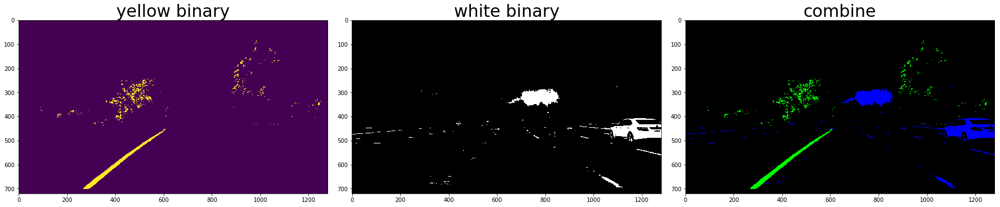

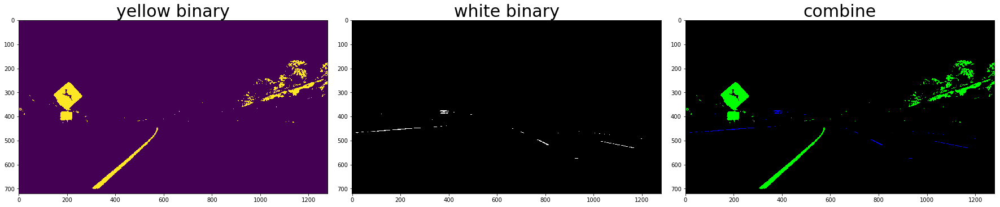

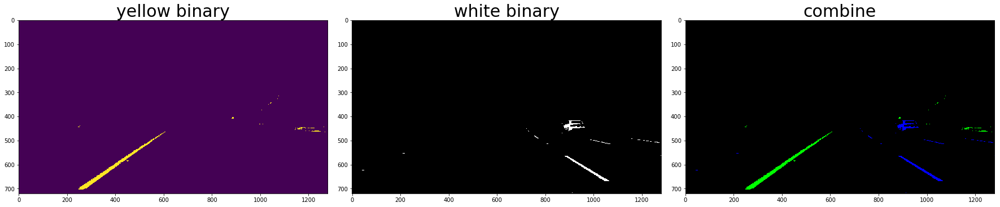

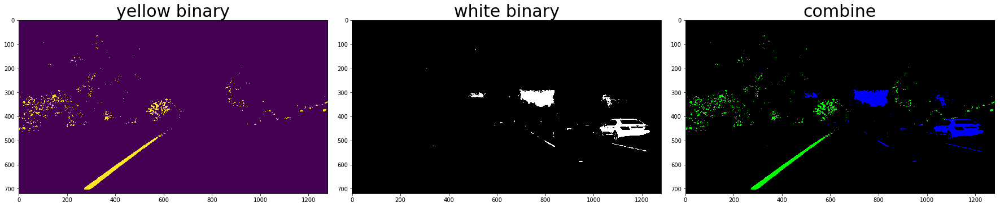

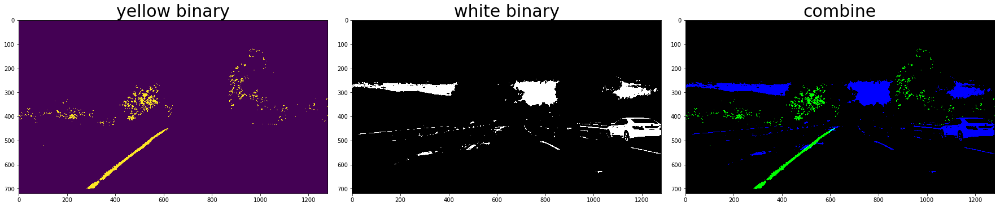

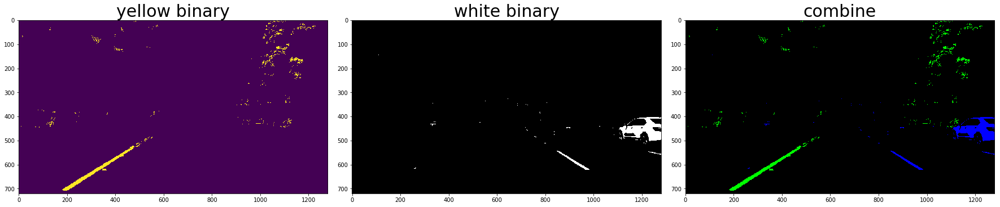

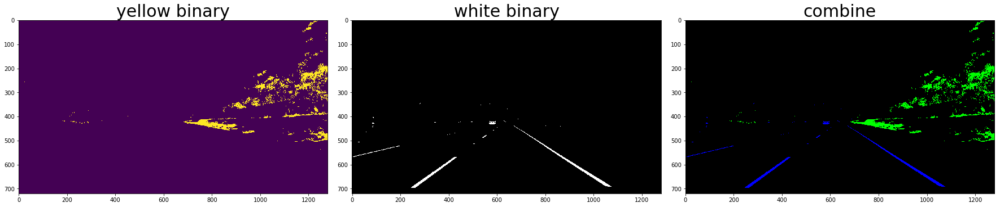

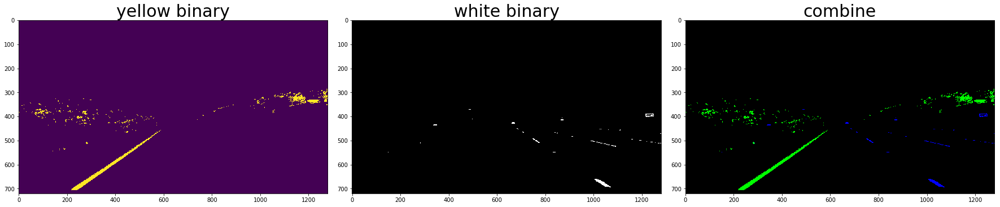

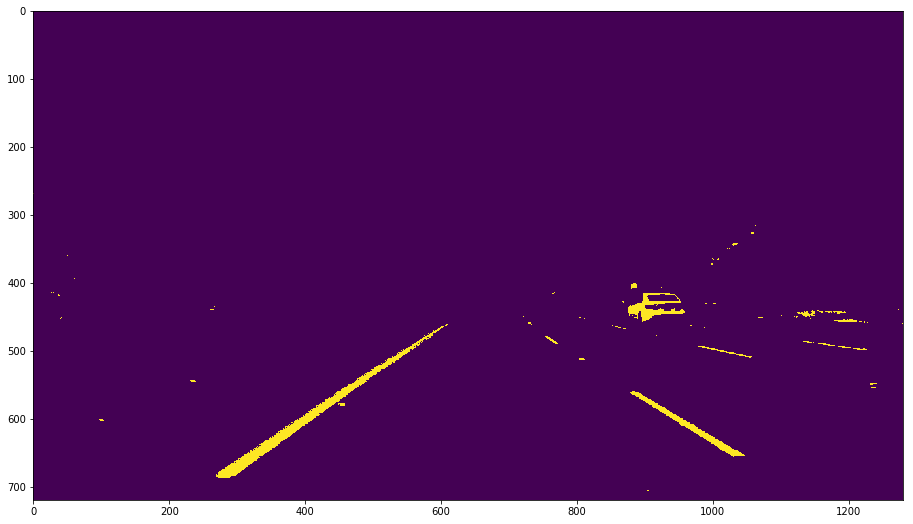

In [356]:
#Yellow(HSV[90,100,100] to HSV[110,255,255]) and White(RGB200 to RGB255) thresholding:

def yellow_white_binary(img,filename="",display=False):
    h,l,s = hls_select(img)
    yellow_binary = np.zeros_like(h)
    
    yellow_binary[((h >= 15) & (h <= 35))
                 & ((l >= 30) & (l <= 204))
                 & ((s >= 115) & (s <= 255))] = 1
    white_binary = np.zeros_like(h)
    white_binary[((h>= 0) & (h <= 255))
                 & ((l>= 200) & (l <= 255))
                 & ((s>= 0) & (s <= 255))] = 1

    
    color_binary = np.dstack(( np.zeros_like(h), yellow_binary, white_binary)) * 255
    if display :
        f, ((ax1, ax2,ax3)) = plt.subplots(1, 3, figsize=(24, 9))
        f.tight_layout()    
        plt.subplots_adjust(left=0., right=1, top=1.5, bottom=0.)
        ax1.imshow(yellow_binary)
        ax1.set_title('yellow binary', fontsize=30)
        ax2.imshow(white_binary,cmap="gray")
        ax2.set_title('white binary', fontsize=30)
        ax3.imshow(color_binary,cmap="gray")
        ax3.set_title('combine', fontsize=30)
        plt.savefig("output_images/yw{0}.jpg".format(filename),bbox_inches='tight')
    combine = np.zeros_like(s)
    combine[(yellow_binary==1) | (white_binary==1)]=1
    return combine

    
example_images = glob.glob("test_output/un*.jpg")
for fname in example_images:
    image = plt.imread(fname)
    yellow_white_binary(image,os.path.split(fname)[1],True)
    
image = plt.imread("test_images/test3.jpg")
combined_yellow_white = yellow_white_binary(image,True)
fig = plt.figure(figsize=(24,9))
plt.imshow(combined_yellow_white)







Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


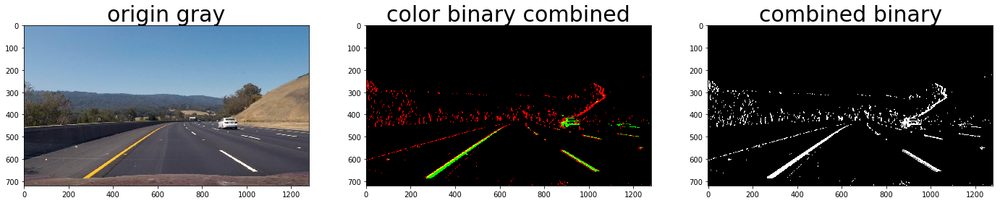

In [357]:
color_binary_combined = np.dstack((combined_grad, combined_yellow_white, np.zeros_like(combined_grad))) * 255

combined_binary = np.zeros_like(gray)
combined_binary[(combined_grad == 1)|(combined_yellow_white == 1)] = 1

fig,((ax1,ax2,ax3)) = plt.subplots(1,3,figsize=(24,9))
ax1.imshow(image)
ax1.set_title('origin gray', fontsize=30)
ax2.imshow(color_binary_combined)
ax2.set_title('color binary combined', fontsize=30)
ax3.imshow(combined_binary,cmap="gray")
ax3.set_title('combined binary', fontsize=30)
plt.savefig("output_images/combine_grad_color.jpg",bbox_inches='tight')


#### 3. Describe how (and identify where in your code) you performed a perspective transform and provide an example of a transformed image.

| Source        | Destination   | 
|:-------------:|:-------------:| 
| 585, 460      | 320, 0        | 
| 203, 720      | 320, 720      |
| 1127, 720     | 960, 720      |
| 695, 460      | 960, 0        |

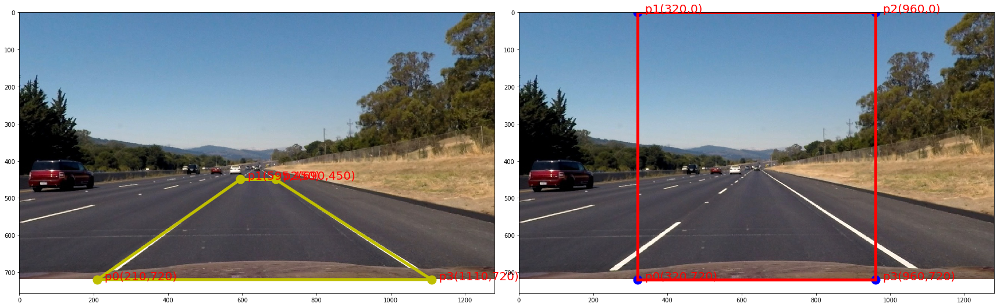

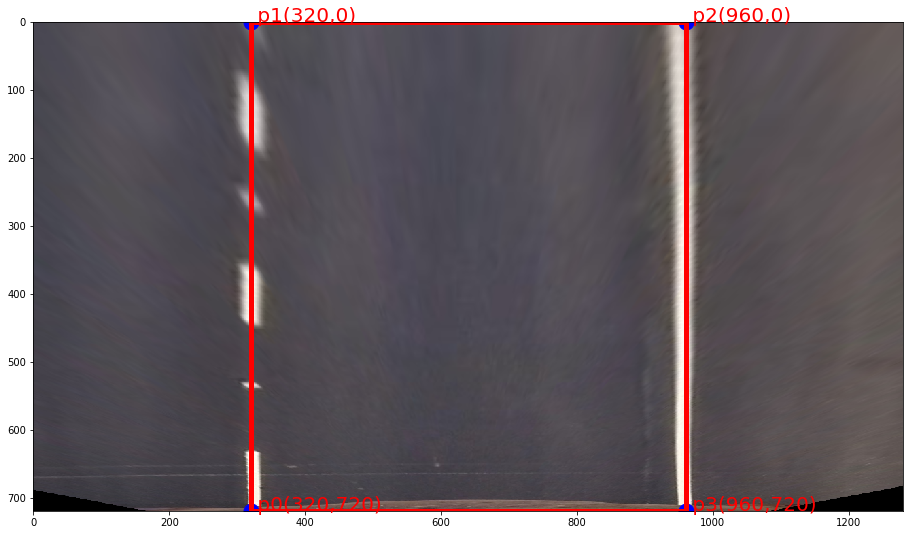

In [368]:
def draw_poly(points,p_color,l_color,text_color,ax=None,fontsize=20):
    xx = []
    yy = []
    for index,v in enumerate(points):
        x,y = v
        if ax:
            ax.annotate("  p{0}({1},{2})".format(index,int(x),int(y)),(x,y),fontsize=fontsize,color=text_color)
            ax.plot(x,y,p_color,markersize="30")
        else:
            plt.annotate(" p{0}({1},{2})".format(index,int(x),int(y)),(x,y),fontsize=fontsize,color=text_color)
            plt.plot(x,y,p_color,markersize="30")
        xx.append(x)
        yy.append(y)
    
    xx.append(xx[0])
    yy.append(yy[0])
    if ax:
        ax.plot(xx,yy,l_color,lw=5)
    else:
        plt.plot(xx,yy,l_color,lw=5)

def get_perspective_func(img):
    shape = img.shape
    img_size = (shape[1], shape[0])
    src = np.float32([[210,img_size[1]],[595,450],[690,450], [1110, img_size[1]]])
    p1 = [(img_size[0] / 4), 0]
    p0 = [(img_size[0] / 4), img_size[1]]
    p2 = [(img_size[0] * 3 / 4), 0]
    p3 = [(img_size[0] * 3 / 4), img_size[1]]
    dst = np.float32([p0,p1,p2,p3])
    
    
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    def get_warped(img):
        return cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    def get_unwarped(img):
        return cv2.warpPerspective(img, Minv, img_size, flags=cv2.INTER_LINEAR)
    
    return get_warped,get_unwarped


def make_perspective(img,display=False):

    warp_func,unwarp_func = get_perspective_func(img)

    warped = warp_func(img)
    unwarped = unwarp_func(img)
    
    if display:
    # Plot the result
        shape = img.shape
        img_size = (shape[1], shape[0])
        src = np.float32([[210,img_size[1]],[595,450],[690,450], [1110, img_size[1]]])
        p1 = [(img_size[0] / 4), 0]
        p0 = [(img_size[0] / 4), img_size[1]]
        p2 = [(img_size[0] * 3 / 4), 0]
        p3 = [(img_size[0] * 3 / 4), img_size[1]]
        dst = np.float32([p0,p1,p2,p3])

        
        f, ((ax1, ax2)) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img,cmap="gray")
        draw_poly(src,'.y','-y','red',ax1)
        ax2.imshow(img,cmap="gray")
        draw_poly(dst,'.b','-r','red',ax2)
        plt.figure(figsize=(24,9))
        draw_poly(dst,'.b','-r','red')
        
        plt.imshow(warped)
    return warped

image = plt.imread("test_images/undistort_straight_lines2.jpg")
warped = make_perspective(image,True)



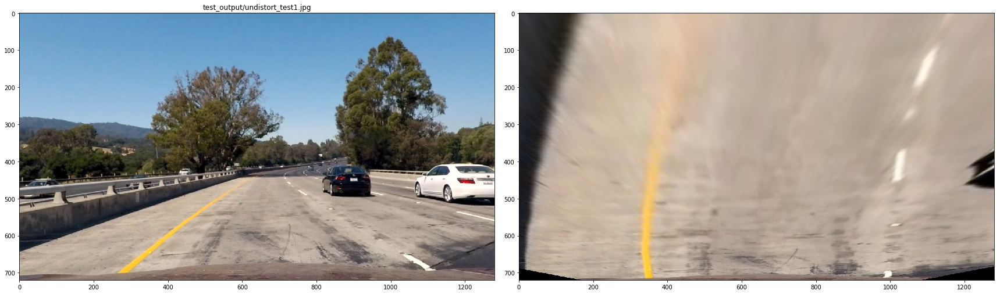

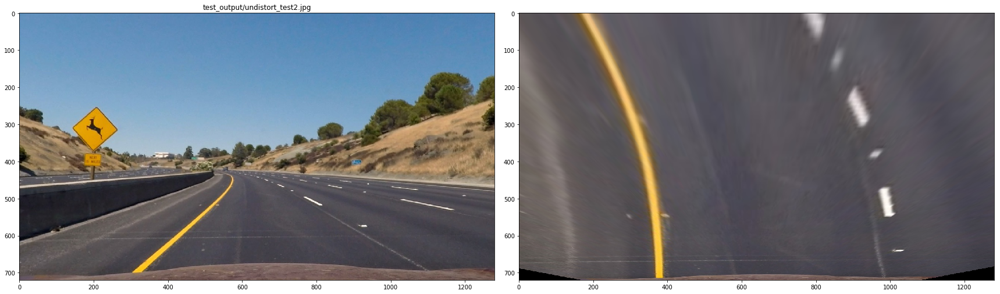

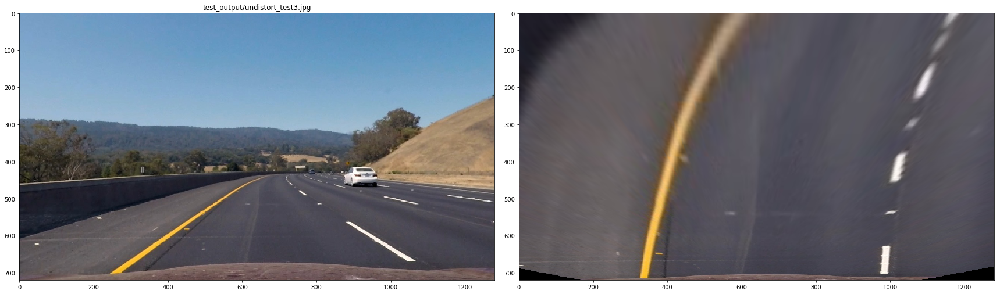

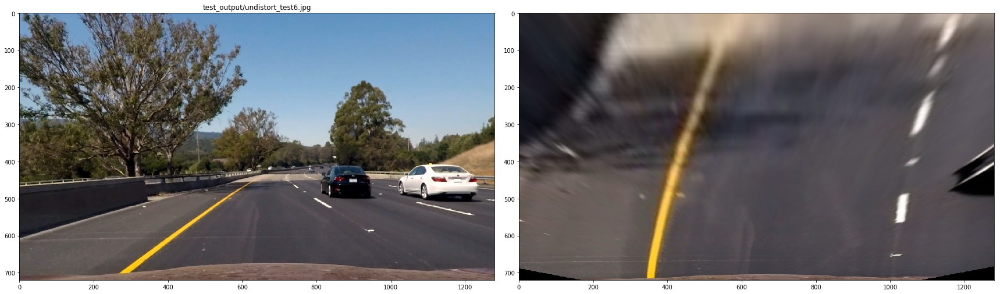

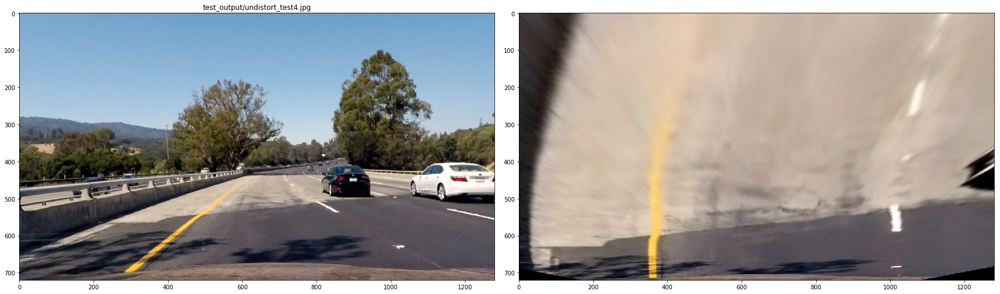

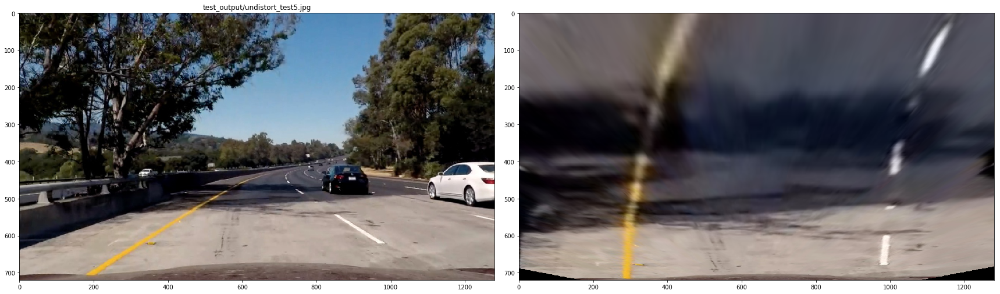

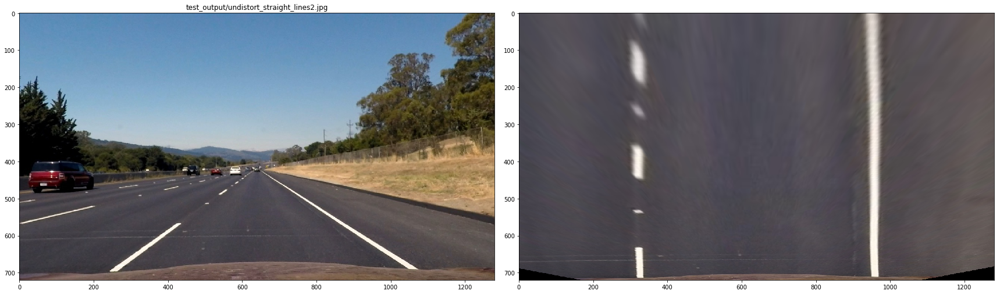

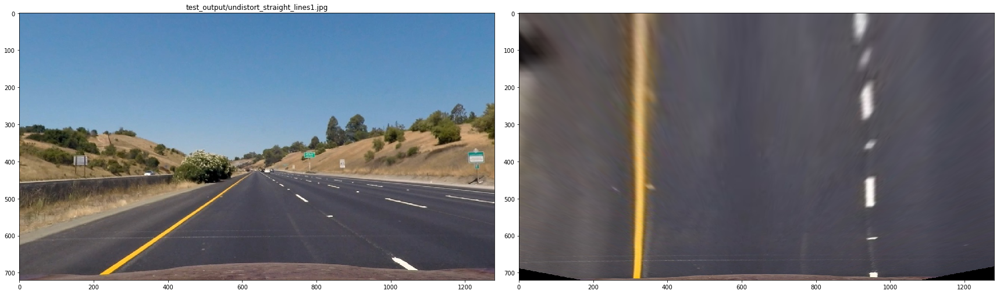

In [375]:

def trans_perspective(images,display=False):
    for fname in images:
        image = plt.imread(fname)
        #image_undistorted = get_undistort_img(image_distorted,mtx,dist)
        warped = make_perspective(image)
        if display:
            f,((ax1,ax2)) = plt.subplots(1,2,figsize=(24, 9))
            f.tight_layout()
            ax1.imshow(image)
            ax1.set_title(fname)
            ax2.imshow(warped)
            plt.savefig("output_images/bird_{0}.jpg".format(os.path.split(fname)[1]),bbox_inches='tight')
            plt.imsave(os.path.split(fname)[0]+"/bird_"+os.path.split(fname)[1],warped)
            
undistort_images = glob.glob('test_output/undistort*.jpg')
trans_perspective(undistort_images,True)


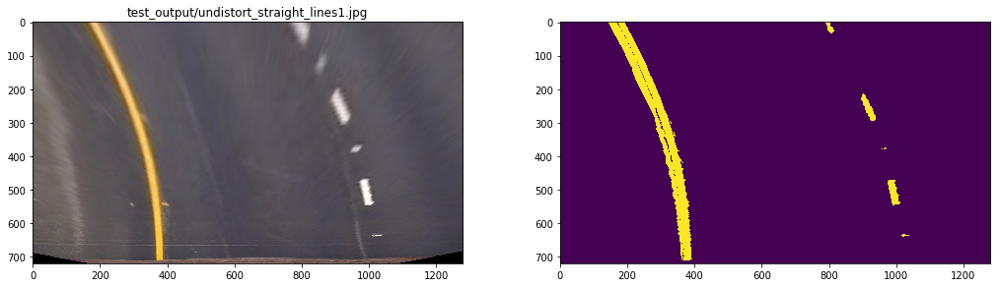

In [376]:
def get_yellow_white_binary(img):
    h,l,s = hls_select(img)
    yellow_binary = np.zeros_like(h)
    
    yellow_binary[((h >= 15) & (h <= 35))
                 & ((l >= 30) & (l <= 204))
                 & ((s >= 115) & (s <= 255))] = 1
    white_binary = np.zeros_like(h)
    white_binary[((h>= 0) & (h <= 255))
                 & ((l>= 200) & (l <= 255))
                 & ((s>= 0) & (s <= 255))] = 1

    combine = np.zeros_like(s)
    combine[(yellow_binary==1) | (white_binary==1)]=1
    return combine


def pipeline_threshold(image):    
    gray = cv2.cvtColor(image,cv2.COLOR_RGB2HLS)[:,:,2]
    grad_binary_x = abs_sobel_thresh(gray, orient='x', thresh=(20,120),kernel_size=15)
    grad_binary_y = abs_sobel_thresh(gray, orient='y', thresh=(20,120),kernel_size=15)
    mag_binary_xy = abs_mag_sobel(gray, thresh=(80,200),kernel_size=15)
    dir_sobel_xy = dir_sobel(gray,thresh=(np.pi/4, np.pi/2),kernel_size=15)
    
    combine_thres = combined_sobels(grad_binary_x,grad_binary_y,mag_binary_xy,dir_sobel_xy)
    combine_yellow_white = get_yellow_white_binary(image)
    
    combined_binary = np.zeros_like(gray)
    combined_binary[(combine_thres == 1)|(combine_yellow_white == 1)] = 1
    
    return combined_binary



_image = plt.imread("test_images/test2.jpg")
bird_view_image = make_perspective(_image)
binary = pipeline_threshold(bird_view_image)
f,((ax1,ax2)) = plt.subplots(1,2,figsize=(15, 4))
f.tight_layout()
ax1.imshow(bird_view_image)
ax1.set_title(fname)
ax2.imshow(binary)

            

#### 4. Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?

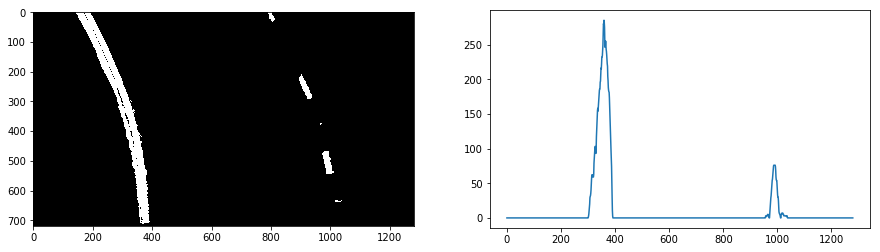

In [379]:
_image = plt.imread("test_images/test2.jpg")
bird_view_image = make_perspective(_image)
binary = pipeline_threshold(bird_view_image)

histogram = np.sum(binary[binary.shape[0]//2:,:], axis=0)

fig, ((ax1,ax2)) = plt.subplots(1, 2, figsize=(15,4))
ax1.imshow(binary, cmap='gray')
ax2.plot(histogram)



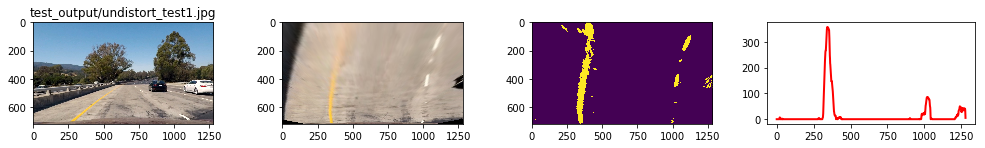

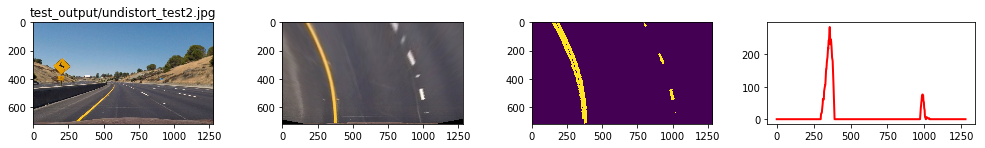

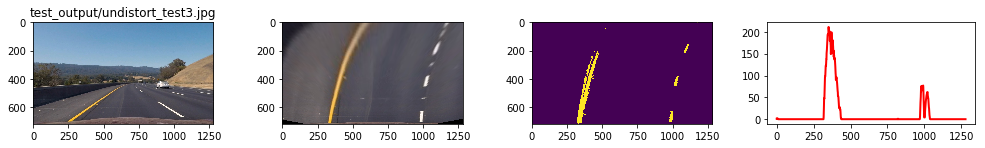

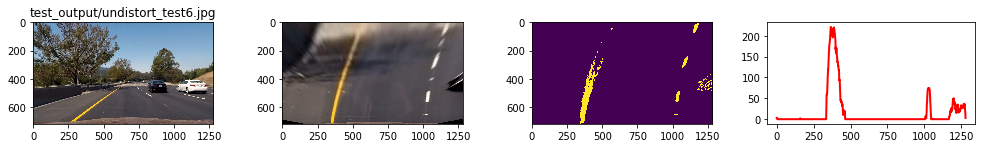

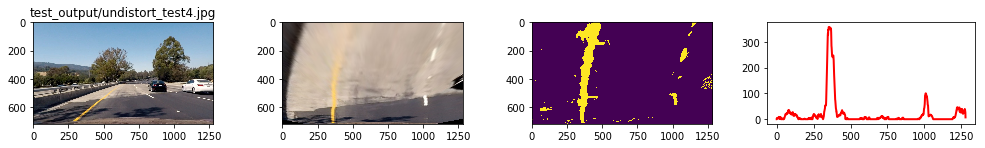

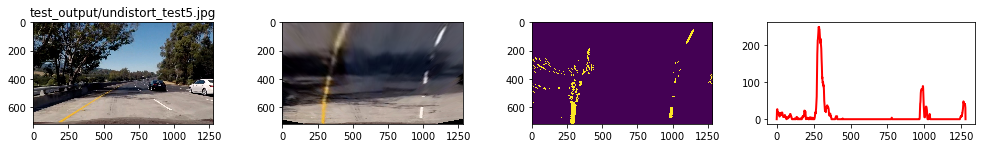

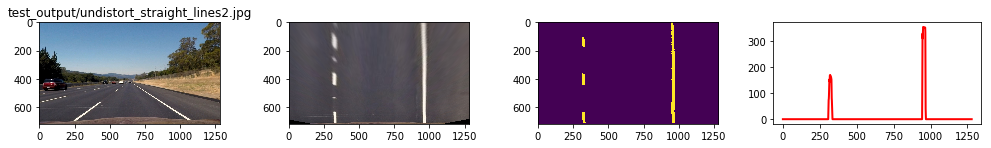

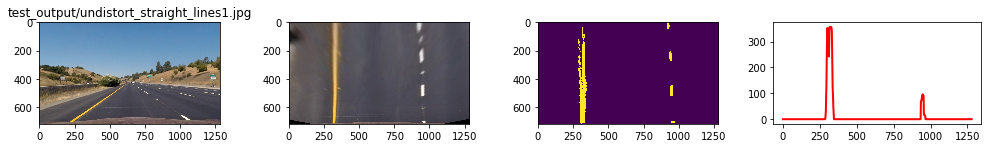

In [378]:

def apply_pipeline(images,display=False):
    for fname in images:
        image = plt.imread(fname)
        bird_view_image = make_perspective(image)
        binary = pipeline_threshold(bird_view_image)
        histogram = np.sum(binary[binary.shape[0]//2:,:], axis=0)
        
        if display:
            f,((ax1,ax2,ax3,ax4)) = plt.subplots(1,4,figsize=(14, 2))
            f.tight_layout()
            ax1.imshow(image)
            ax1.set_title(fname)
            ax2.imshow(bird_view_image)
            ax3.imshow(binary)
            ax4.plot(histogram,'r-',lw=2)
            plt.savefig("output_images/findline_{0}.jpg".format(os.path.split(fname)[1]),bbox_inches='tight')


undistort_images = glob.glob('test_output/undistort*.jpg')
apply_pipeline(undistort_images,True)

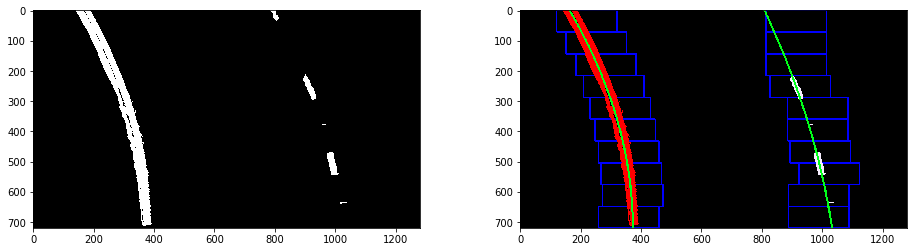

In [387]:

def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2) # 直方图的中点
    leftx_base = np.argmax(histogram[:midpoint]) # 左半部分最大值坐标
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint #右半部分最大值坐标
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 10
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()#np.nonzero函数是numpy中用于得到数组array中非零元素的位置（数组索引）的函数
    # nonzeroy.shape = nonzerox.shape = 1280*760
    nonzeroy = np.array(nonzero[0])# 非0元素的y索引，其实就是坐标
    nonzerox = np.array(nonzero[1])# 非0元素的x索引，其实就是坐标

    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        ### 绘制一个矩形，用直方图最大值向两侧偏离margin
        win_xleft_low = leftx_current - margin   # Update this
        win_xleft_high = leftx_current + margin  # Update this
        win_xright_low = rightx_current - margin  # Update this
        win_xright_high = rightx_current + margin  # Update this
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,0,255), 4) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,0,255), 4) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        ### 在对于包围框中的元素，取其x坐标
        ### nonzeroy是一个一维向量,长度为1280*760，存放图中所有像素点的y坐标，x坐标同理
        ### 下面面的操作首先进行逻辑运算筛选符合条件的索引，符合条件的为True，否则为False
        ### 然后用nonzero把所有True的点的索引取出来，也就是说在nonzeroy中满足条件的点的索引
        ### 用该索引取nonzeroy的值，得到的就是该点的y坐标
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
                
        
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        ## 遍历9个窗口，如果窗口内的像素点个数超过了minpix，就把窗口的终点移至这些像素点的终点
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))# 索引取nonzeroy的值，得到的就是该点的x坐标
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            
    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        # left_lane_inds 是包含一组列表的列表，concatenate将它们合成一个列表
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    return leftx, lefty, rightx, righty, out_img



def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    # y轴每1个像素创建一个坐标点
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [247, 238, 255]
    
    pts_left=np.array([[x,y] for x,y in zip(left_fitx,ploty)],np.int32).reshape((-1,1,2))
    pts_right=np.array([[x,y] for x,y in zip(right_fitx,ploty)],np.int32).reshape((-1,1,2))
    
    #R247 G238 B214
    cv2.polylines(out_img,pts_left,True,(0,255,25),5)
    cv2.polylines(out_img,pts_right,True,(0,255,25),5)


    return out_img,left_fit,right_fit

_image = plt.imread("test_images/test2.jpg")
bird_view_image = make_perspective(_image)
binary = pipeline_threshold(bird_view_image)
out_img ,left_fit,right_fit = fit_polynomial(binary)

fig, ((ax1,ax2)) = plt.subplots(1, 2, figsize=(16,4))
ax1.imshow(binary, cmap='gray')
ax2.imshow(out_img)
plt.savefig("output_images/find_lane_pixels.jpg",bbox_inches='tight')

#plt.imshow(out_img)

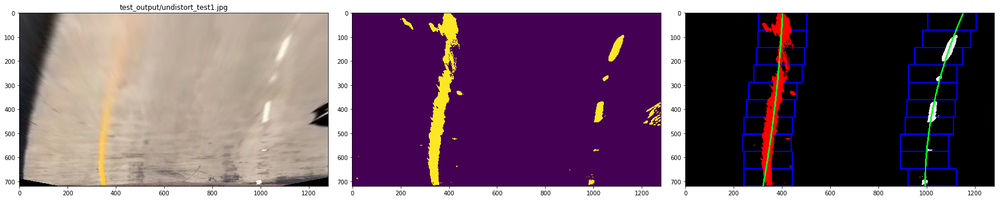

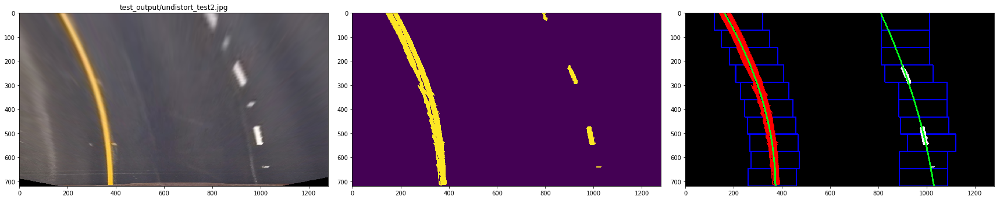

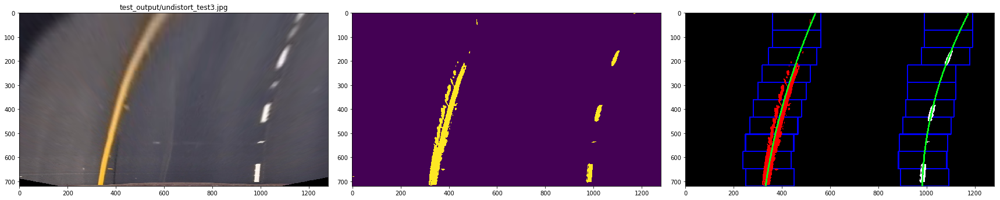

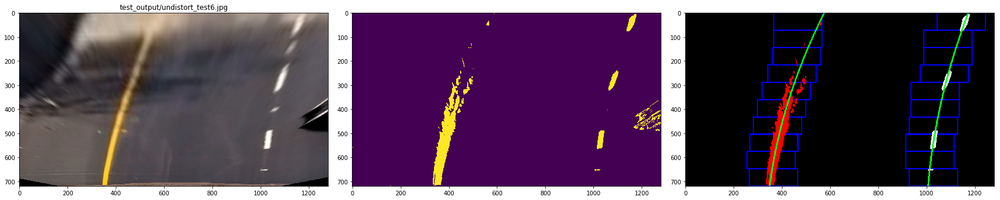

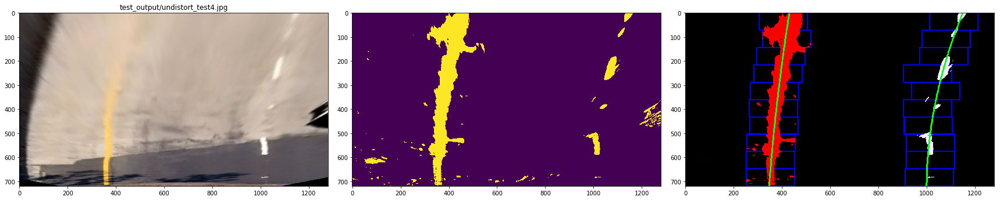

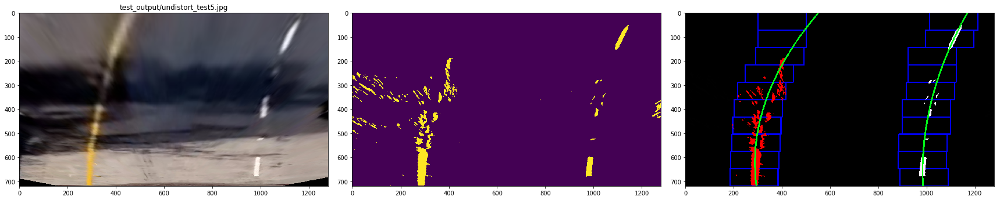

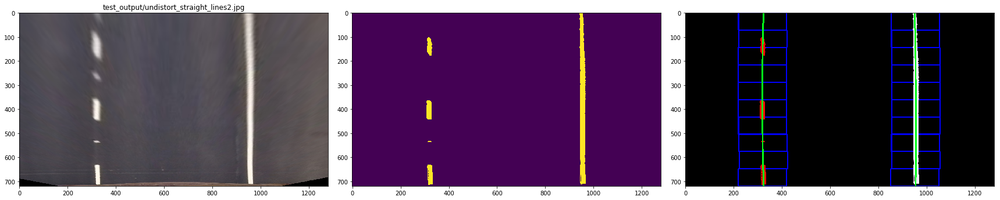

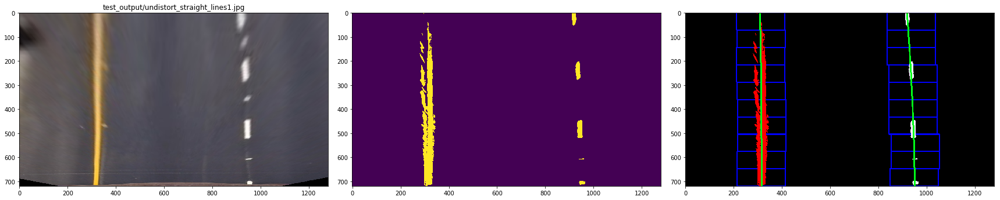

In [388]:
def find_lines_pix(images,display=False):
    for fname in images:
        image = plt.imread(fname)
        bird_view_image = make_perspective(image)
        binary = pipeline_threshold(bird_view_image)
        out_img ,left_fit,right_fit = fit_polynomial(binary)
        
        if display:
            f,((ax2,ax3,ax4)) = plt.subplots(1,3,figsize=(24, 9))
            f.tight_layout()
            #ax1.imshow(image)
            ax2.set_title(fname)
            ax2.imshow(bird_view_image)
            ax3.imshow(binary)
            ax4.imshow(out_img)
            plt.savefig("output_images/findpix_{0}.jpg".format(os.path.split(fname)[1]),bbox_inches='tight')

undistort_images = glob.glob('test_output/undistort*.jpg')
find_lines_pix(undistort_images,True)

#### 5. Describe how (and identify where in your code) you calculated the radius of curvature of the lane and the position of the vehicle with respect to center.

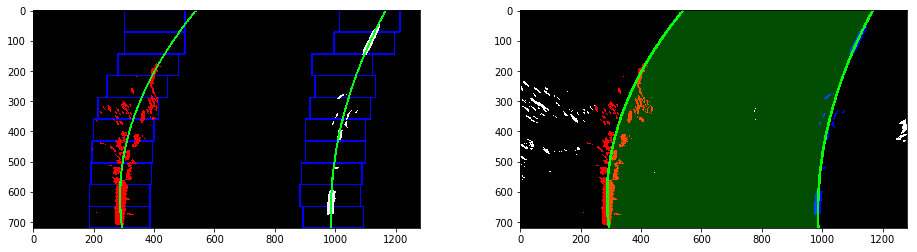

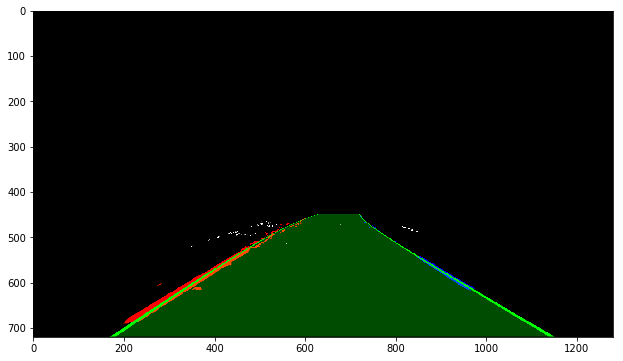

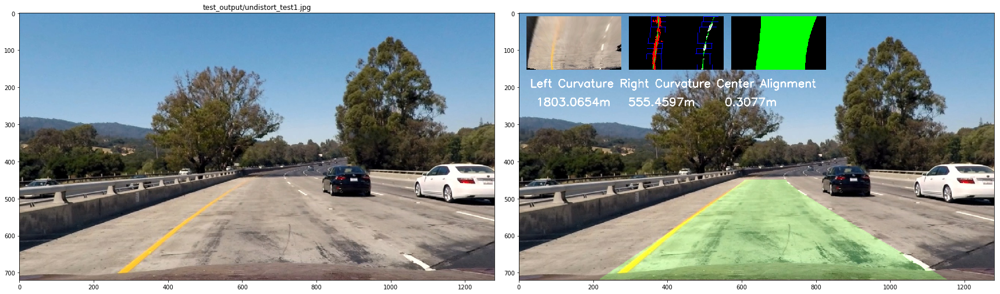

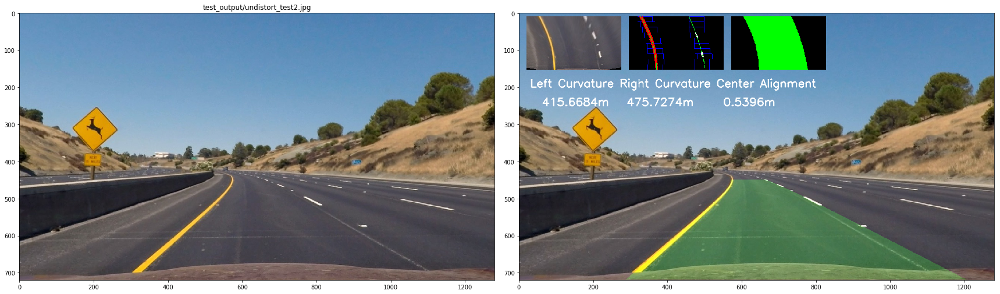

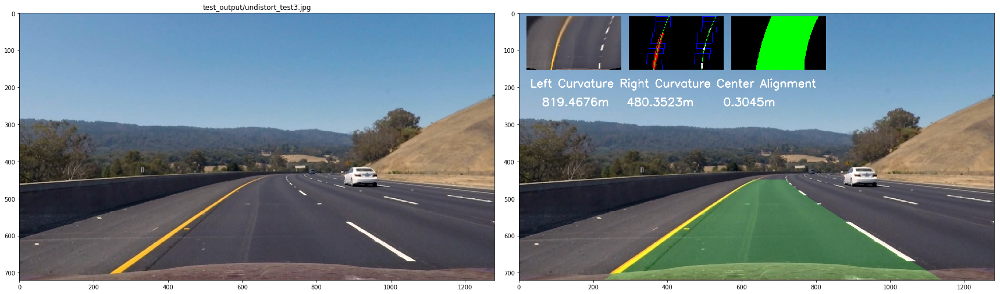

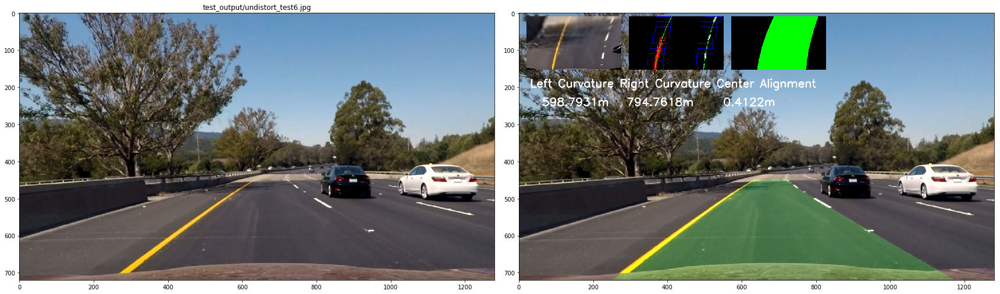

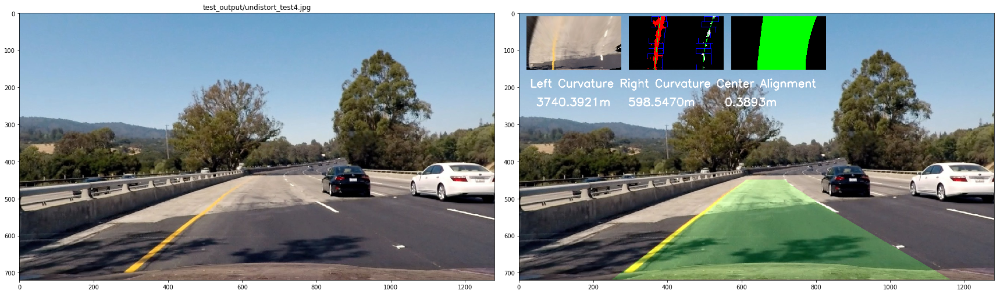

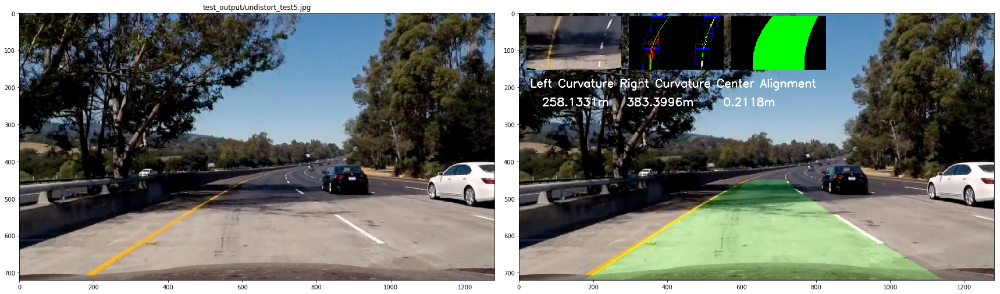

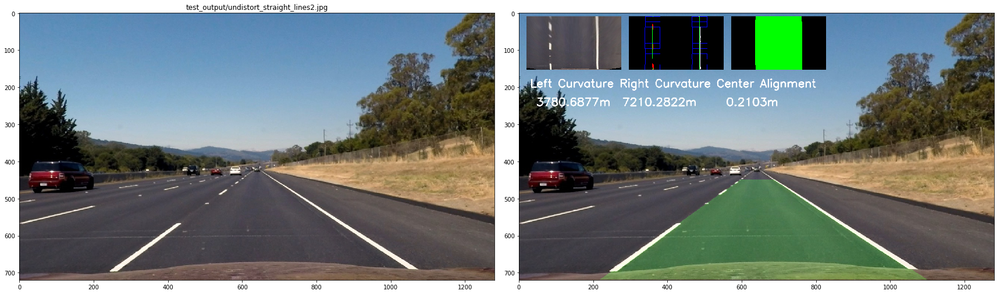

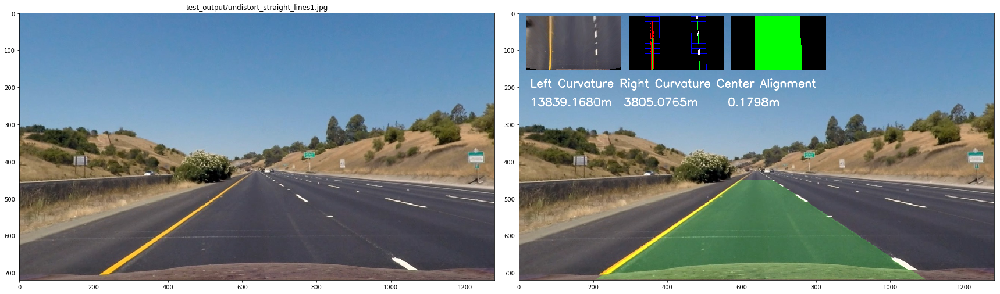

In [390]:




ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # 
lane_center_px_psp = 600
def fit_poly(img_shape, leftx, lefty, rightx, righty,left_fit,right_fit):
     ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    y_eval = np.max(ploty)
    ##### TO-DO: Implement the calculation of R_curve (radius of curvature) #####
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    center_offset = (((left_fit[0] * y_eval**2 + left_fit[1] * y_eval + left_fit[2]) + 
                   (right_fit[0] * y_eval**2 + right_fit[1] * y_eval + right_fit[2])) / 2) - lane_center_px_psp
        
    center_offset = center_offset*xm_per_pix
    return left_fitx, right_fitx, ploty,left_curverad,right_curverad,center_offset

def search_around_poly(binary_warped,left_fit,right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    left_fit = np.array(left_fit)
    right_fit = np.array(right_fit)
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty ,left_curverad,right_curverad,center_offset = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty,left_fit,right_fit)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    # 绘制所有的点并着色
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    #left_fitx为曲线x坐标，left_fitx-margin为多边形的左边，在列方向拼上一个包含y坐标的行向量
    # 然后再用转至的方法，转换为一组xy坐标
    # [[1,2,3]
    # [3,4,5]] #后拼接的
    # [[1,3]
    # [2,4]
    # [3,5]]
    # flipud:上下颠倒矩阵
    # [[3,5]
    # [2,4]
    # [1,3]] 
    # 这里需要颠倒的原因是因为我们是绘制多边形，按照一个方向旋转，一边向上的话，另一边就向下了
    left_line = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_line = np.array([np.flipud(np.transpose(np.vstack([right_fitx,ploty])))])
    
    pts_t = np.hstack((left_line, right_line))
    
    left_line_pts = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_line_pts = np.array([np.transpose(np.vstack([right_fitx,ploty]))])
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([pts_t]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    cv2.polylines(result,np.int_([left_line_pts]),False,(0,255,0),8)# should set to Flase 
    cv2.polylines(result,np.int_([right_line_pts]),False,(0,255,0),8)
    
    return result,window_img,left_curverad,right_curverad,center_offset

# Run image through the pipeline
# Note that in your project, you'll also want to feed in the previous fits

_image = plt.imread("test_images/test5.jpg")
bird_view_image = make_perspective(_image)
binary = pipeline_threshold(bird_view_image)
out_img ,left_fit,right_fit = fit_polynomial(binary)
result,window,left_curverad,right_curverad,center_offset = search_around_poly(binary,left_fit,right_fit)

fig, ((ax1,ax2)) = plt.subplots(1, 2, figsize=(16,4))
ax1.imshow(out_img, cmap='gray')
ax2.imshow(result)

warp_func,unwarp_func = get_perspective_func(_image)

unwarped = unwarp_func(result)

plt.figure(figsize=(16,6))
plt.imshow(unwarped)



def combine_images(lane_area_img, bird_view, slide_window, binary):        
    """
    Returns a new image made up of the lane area image, and the remaining lane images are overlaid as
    small images in a row at the top of the the new image
    """
    small_img_size = (256, 144)
    small_bird_view = cv2.resize(bird_view, small_img_size)
    small_slide_window = cv2.resize(slide_window, small_img_size)
    small_binary = cv2.resize(binary, small_img_size)
    small_img_x_offset  = 20
    small_img_y_offset  = 10

    lane_area_img[small_img_y_offset: small_img_y_offset + small_img_size[1], small_img_x_offset: small_img_x_offset + small_img_size[0]] = small_bird_view

    start_offset_y = small_img_y_offset 
    start_offset_x = 2 * small_img_x_offset + small_img_size[0]
    lane_area_img[start_offset_y: start_offset_y + small_img_size[1], start_offset_x: start_offset_x + small_img_size[0]] = small_slide_window

    start_offset_y = small_img_y_offset 
    start_offset_x = 3 * small_img_x_offset + 2 * small_img_size[0]
    lane_area_img[start_offset_y: start_offset_y + small_img_size[1], start_offset_x: start_offset_x + small_img_size[0]] = small_binary

    return lane_area_img

def draw_text(image,left_curvature_meters,right_curvature_meters,center_offset_meters):
    
    font = cv2.FONT_HERSHEY_SIMPLEX  
    txt_template = template = "{0:10} {1:10} {2:10}"
    txt_header = txt_template.format("Left Curvature", "Right Curvature","Center Alignment") 

    txt_values = template.format("{:10.4f}m".format(left_curvature_meters), 
                                     "{:10.4f}m".format(right_curvature_meters),
                                     "{:10.4f}m".format(center_offset_meters))
    
    cv2.putText(image,txt_header,(30,200), font, 1,(255,255,255),2,cv2.LINE_AA)  
    cv2.putText(image,txt_values,(30,250), font, 1,(255,255,255),2,cv2.LINE_AA)  
    return image
    
def process_pipeline(image):
    bird_view_image = make_perspective(image)
    binary = pipeline_threshold(bird_view_image)
    out_img ,left_fit,right_fit = fit_polynomial(binary)
    result,window,left_curverad,right_curverad,center_offset = search_around_poly(binary,left_fit,right_fit)
    unwarped = unwarp_func(window)
    output = cv2.addWeighted(image, 1, unwarped, 0.2, 0)
    output = combine_images(output,bird_view_image,out_img,window)
    output = draw_text(output,left_curverad,right_curverad,center_offset)
    return output


undistort_images = glob.glob('test_output/undistort*.jpg')
for fname in undistort_images:
    image = plt.imread(fname)
    output = process_pipeline(image)
    
    f,((ax1,ax2)) = plt.subplots(1,2,figsize=(24, 9))
    f.tight_layout()
    #ax1.imshow(image)
    ax1.set_title(fname)
    ax1.imshow(image)
    #ax3.imshow(out_img)
    ax2.imshow(output)
    plt.savefig("output_images/calculate_cr_{0}.jpg".format(os.path.split(fname)[1]),bbox_inches='tight')
            

## apply to vedio

In [384]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML




In [385]:
i = 0
output_target = 'test_output/test.mp4'

## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clip1 = VideoFileClip("project_video.mp4").subclip(0,5)
#clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4")
white_clip = clip1.fl_image(process_pipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(output_target, audio=False)
#white_clip = white_clip.resize(0.5)
#white_clip.write_gif("examples/solidWhiteRight.gif",fps=10,fuzz=1)
#draw_imgs(error_img)

[MoviePy] >>>> Building video test_output/test.mp4
[MoviePy] Writing video test_output/test.mp4



 99%|█████████▉| 125/126 [00:52<00:00,  2.36it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_output/test.mp4 

CPU times: user 1min 22s, sys: 10.4 s, total: 1min 33s
Wall time: 54.6 s


In [386]:
i = 0
output_target = 'test_output/test_challenge.mp4'

## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clip1 = VideoFileClip("harder_challenge_video.mp4").subclip(0,5)
#clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4")
white_clip = clip1.fl_image(process_pipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(output_target, audio=False)
#white_clip = white_clip.resize(0.5)
#white_clip.write_gif("examples/solidWhiteRight.gif",fps=10,fuzz=1)
#draw_imgs(error_img)

[MoviePy] >>>> Building video test_output/test_challenge.mp4
[MoviePy] Writing video test_output/test_challenge.mp4



 99%|█████████▉| 125/126 [00:57<00:00,  2.18it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_output/test_challenge.mp4 

CPU times: user 1min 28s, sys: 10.2 s, total: 1min 38s
Wall time: 59.8 s
